# Data Cleaning and Exploration

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
import string

In [2]:
%matplotlib inline

In [3]:
%load_ext rpy2.ipython 

In [4]:
meta = pd.read_csv("Meta.csv", index_col='siteid2')

In [5]:
temp = pd.read_csv("Temporal.csv", index_col='timestamp', parse_dates=True)

In [6]:
temp.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43824 entries, 2010-01-01 00:00:00 to 2015-12-31 23:00:00
Columns: 609 entries, CollegeClassroom_ASU_AgribusinessCenter to PrimarySecondaryClassroom_enernoc2012_WestBethanyDrive
dtypes: float64(609)
memory usage: 204.0 MB


# Uniform cleaning and outlier removal

- Remove point outliers that are outside 3 standard deviations from the mean
- Make gaps where a single day has no variation at all - ie: min = max for the day
- Remove all negative values

In [7]:
temp.count().mean()

8620.208538587849

In [8]:
temp = temp[temp>=0]

In [9]:
temp.count().mean()

8620.200328407225

In [10]:
#Remove gross outliers
for column in temp.columns:
    S = temp[column]
    temp[column] = S[~((S-S.mean()).abs()>3*S.std())]

In [15]:
temp.count().mean()

8574.771756978653

Replace flat-lined days with NaN

In [35]:
# #We need to remove the flat days -- use guidance from: http://stackoverflow.com/questions/27488080/python-pandas-filter-rows-after-groupby 
# temp_gaps = pd.DataFrame()
# for building_name in temp.columns:
#     #print "Processing building: "+building_name
#     grouped = temp.groupby(temp.index.date)
#     filtered = pd.DataFrame(grouped.filter(lambda x: x[building_name].min() / x[building_name].max() != 1)[building_name])
#     #electricity[building_name].update(filtered)
#     filtered.columns = [building_name]
#     #elec_with_gaps.append(filtered)
#     temp_gaps = pd.merge(temp_gaps, filtered, right_index=True, left_index=True, how='outer')

In [36]:
temp_gaps.count().mean()

8570.47290640394

In [37]:
#temp_gaps.ix[:,:100].info()

# Create Line Charts to view samples of the data

In [16]:
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
import datetime
import cufflinks as cf
cf.go_offline()
init_notebook_mode() # run at the start of every ipython notebook to use plotly.offline

In [17]:
#temp.ix[:,:100].plot(figsize=(20,100), subplots=True);

# Convert to 2015 data 

For uniformity and visualization of analysis - create a dataset in which the common year is 2015 -- this is for visualization purposes and not analysis

In [18]:
def changeto2015(x):
    try:
        return x.replace(year=2015)
    except:
        return np.nan

In [19]:
temp2015 = pd.DataFrame()

In [20]:
for dataset in meta.dataset.unique():
    #print dataset
    subset = temp[temp.columns[temp.columns.str.contains("_"+dataset+"_")]].dropna(how='all')#.info()
    subset.index = subset.index.map(lambda t: changeto2015(t))
    temp2015 = pd.merge(temp2015, subset, right_index=True, left_index=True, how='outer')


In [21]:
temp2015 = temp2015.resample('H').sort_index()#.info()


In [35]:
temp2015.ix[:,4:46]

,CollegeClassroom_ASU_CLCC2,CollegeClassroom_ASU_CODNorth,CollegeClassroom_ASU_CODSouth,CollegeClassroom_ASU_ClassroomBuilding,CollegeClassroom_ASU_CowdenFamilyResources,CollegeClassroom_ASU_CreativityHall,CollegeClassroom_ASU_Cronkite,CollegeClassroom_ASU_DiscoveryHall,CollegeClassroom_ASU_EducationLectureHall,CollegeClassroom_ASU_EngineeringG,...,CollegeLaboratory_ASU_EngineeringResearchCtr,CollegeLaboratory_ASU_Goldwater,CollegeLaboratory_ASU_ISTB1,CollegeLaboratory_ASU_ISTB2,CollegeLaboratory_ASU_ISTB3,CollegeLaboratory_ASU_ISTB4,CollegeLaboratory_ASU_ISTB5,CollegeLaboratory_ASU_InterdisciplinaryAB,CollegeLaboratory_ASU_LifescienceA_B_D,CollegeLaboratory_ASU_LifescienceC
2015-01-01 00:00:00,172.78,87.88,29.48,22.57,23.74,43.02,243.72,4.92,4.07,31.15,...,717.96,555.00,924.47,165.95,243.07,898.79,187.11,149.53,147.73,250.33
2015-01-01 01:00:00,171.93,86.14,28.98,22.28,23.70,43.12,234.74,4.89,4.02,31.16,...,718.60,550.85,916.78,165.35,242.20,887.98,184.52,140.57,148.08,249.82
2015-01-01 02:00:00,172.92,85.83,28.69,22.76,23.93,45.93,233.99,4.90,3.99,31.08,...,716.62,552.54,921.68,165.87,241.95,892.02,184.86,149.16,150.33,250.59
2015-01-01 03:00:00,171.06,86.44,29.30,22.05,24.89,43.04,233.80,4.80,4.00,30.73,...,717.12,551.19,927.16,169.46,242.46,889.06,183.72,145.30,150.39,250.34
2015-01-01 04:00:00,171.59,86.73,29.01,21.76,23.61,42.93,234.13,4.89,4.09,30.93,...,715.88,545.79,915.06,167.73,241.53,881.37,182.57,144.67,151.69,249.48
2015-01-01 05:00:00,174.36,85.85,29.71,21.79,25.03,45.78,234.63,4.89,4.02,34.83,...,720.29,548.72,926.84,169.63,241.92,887.29,185.16,127.80,151.49,250.74
2015-01-01 06:00:00,174.94,86.64,29.30,26.20,24.86,NaN,248.70,4.79,4.08,42.55,...,722.53,551.35,925.41,169.84,243.25,900.30,184.39,121.37,151.31,250.12
2015-01-01 07:00:00,164.79,87.99,28.35,28.11,25.12,NaN,258.73,4.91,4.04,42.86,...,717.05,557.07,912.06,167.57,243.01,899.85,185.02,116.60,152.76,250.46
2015-01-01 08:00:00,150.42,84.53,27.25,27.24,23.92,NaN,252.43,5.84,4.17,39.49,...,719.15,552.59,925.97,164.54,246.37,900.16,184.12,112.45,152.46,253.27
2015-01-01 09:00:00,150.54,83.58,26.95,27.36,25.27,205.80,251.18,8.54,4.22,39.87,...,717.83,550.43,929.10,163.32,243.75,896.99,181.79,113.24,159.59,252.15


In [36]:
temp2015.ix[:,4:46].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8760 entries, 2015-01-01 00:00:00 to 2015-12-31 23:00:00
Data columns (total 42 columns):
CollegeClassroom_ASU_CLCC2                      8662 non-null float64
CollegeClassroom_ASU_CODNorth                   8619 non-null float64
CollegeClassroom_ASU_CODSouth                   8690 non-null float64
CollegeClassroom_ASU_ClassroomBuilding          8678 non-null float64
CollegeClassroom_ASU_CowdenFamilyResources      8690 non-null float64
CollegeClassroom_ASU_CreativityHall             8628 non-null float64
CollegeClassroom_ASU_Cronkite                   8668 non-null float64
CollegeClassroom_ASU_DiscoveryHall              8690 non-null float64
CollegeClassroom_ASU_EducationLectureHall       8658 non-null float64
CollegeClassroom_ASU_EngineeringG               8690 non-null float64
CollegeClassroom_ASU_FarmersEducation           8690 non-null float64
CollegeClassroom_ASU_LangandLit                 8690 non-null float64
CollegeClassroom_

In [113]:
layout = go.Layout(
    #xaxis = dict(tickformat='%b %d', title='Date'),
    #yaxis = dict(ticks='', nticks=50, title='Hourly kWh'),
    autosize=False,
    width=1000,
    height=700,
    showlegend=False,
    hovermode=False)

In [114]:
#temp2015.iloc[:,:10].info()#.iplot(subplots=True, layout=layout)

# Demo for the presentation looking different types of buildings

In [147]:
temp2015[temp2015>0].iloc[:,[99,600,70,4]].iplot(subplots=True, shape=(4,1), layout=layout, shared_xaxes=True)

In [184]:
temp2015.ix[:,:250].info()#.plot(subplots=True, figsize=(15,50), legend=False);

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8760 entries, 2015-01-01 00:00:00 to 2015-12-31 23:00:00
Columns: 250 entries, CollegeClassroom_ASU_AgribusinessCenter to PrimarySecondaryClassroom_Cardiff_LlanedeyrnPrimarySchool
dtypes: float64(250)
memory usage: 16.8 MB


In [185]:
# for dataset in meta.dataset.unique():
#     subset = temp2015[temp2015.columns[temp2015.columns.str.contains(dataset)]]#.dropna(how='all')
#     subset.plot(figsize=(15,150), subplots=True);

In [186]:
#temp_dateless = temp2015.reset_index(drop=True)

In [187]:
#temp_dateless.info()

# Normalized Consumption

Let's go through and remove the extreme outliers in terms of average daily kwh/m2 - this will remove the absurdly high values due to the wrong square footage, etc.

In [188]:
def plotheatmap(df, colorscale):
    data = [
        go.Heatmap(
            z=np.array(df.fillna(df.mean()).T),
            x=df.index,
            y=df.columns,
            colorscale=colorscale,
        )
    ]
    layout = go.Layout(
        xaxis = dict(tickformat='%B %d'),
        yaxis = dict(ticks='', nticks=50),
        width=1000,
        height=700,
        margin= dict(
        l=300,
        t=20
        )
    )
    fig = go.Figure(data=data, layout=layout)
    iplot(fig, show_link=False)

In [189]:
def plotheatmap_nolabels(df, colorscale):
    data = [
        go.Heatmap(
            z=np.array(df.fillna(df.mean()).T),
            x=df.index,
            y=df.columns,
            colorscale=colorscale,
        )
    ]
    layout = go.Layout(
        xaxis = dict(tickformat='%B %d', title='Date'),
        yaxis = dict(ticks='', nticks=50, title='Building Number'),
        width=1000,
        height=600
#         margin= dict(
#         l=300,
#         t=20
#         )
    )
    fig = go.Figure(data=data, layout=layout)
    iplot(fig, show_link=False)

In [190]:
temp_norm = temp2015/meta.sqm
temp_norm = temp_norm.T.ix[temp_norm.T.sum(axis=1).sort_values().index].T
temp_norm_daily = temp_norm.resample('D', how='sum')

In [191]:
notbigaccounts = temp_norm_daily.mean() > 3

In [192]:
#notbigaccounts

In [193]:
#temp[notbigaccounts[notbigaccounts == False].index]

It looks like the top 8 are above 3 kwh/m2/day which is pretty high -- let's cut off the top 9 to round out the study at 600 buildings

In [194]:
temp_norm_daily= temp_norm_daily[temp_norm_daily.ix[:,:-9].columns]

In [198]:
temp_norm_daily.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 365 entries, 2015-01-01 to 2015-12-31
Freq: D
Columns: 600 entries, PrimarySecondaryClassroom_enernoc2012_232BurgundyLane to CollegeLaboratory_ASU_MTWResearchPark
dtypes: float64(600)
memory usage: 1.7 MB


In [204]:
plotheatmap_nolabels(temp_norm_daily[temp_norm_daily<1].T.reset_index(drop=True).T, 'hot')

In [203]:
data = [
    go.Heatmap(
        z=np.array(temp_norm_daily[temp_norm_daily < 1].fillna(temp_norm_daily[temp_norm_daily < 1].mean()).T),
        x=temp_norm_daily.index,
        y=temp_norm_daily.columns,
        colorscale='hot',
    )
]

layout = go.Layout(
    xaxis = dict(tickformat='%b %d'),
    yaxis = dict(ticks='', nticks=50),
    width=1000,
    height=700,
    margin= dict(
    l=300,
    t=20
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [205]:
temp_toplot = temp2015.resample("D", how='sum')

In [210]:
trace1 = go.Scatter(
    x = temp_toplot.index,
    y = temp_toplot.CollegeClassroom_ASU_AgribusinessCenter,
    mode='lines+markers',
    marker=dict(
        size='10',
        color = temp_norm.resample('D',how='sum').CollegeClassroom_ASU_AgribusinessCenter, #set color equal to a variable
        colorscale='hot',
        showscale=True
    )
)

layout = go.Layout(
    title = "Normalized Consumption - kWh/m2/day",
    xaxis = dict(tickformat='%b %d'),
    width=1000,
    height=300
)

fig = go.Figure(data=[trace1], layout=layout)

iplot(fig)

In [157]:
temp_norm = temp_norm[temp_norm_daily.ix[:,:-9].columns]

NameError: name 'temp_norm' is not defined

In [55]:
annual_sum = pd.DataFrame({"KWh/m2/year":temp_norm.fillna(temp_norm.mean()).sum()}).reset_index()

In [56]:
s = annual_sum['index']

In [57]:
annual_sum = annual_sum.join(s.apply(lambda x: pd.Series(x.split('_'))))

In [58]:
annual_sum.head()

,index,KWh/m2/year,0,1,2,3,4
0,PrimarySecondaryClassroom_enernoc2012_232Burgu...,2.162097,PrimarySecondaryClassroom,enernoc2012,232BurgundyLane,NaN,NaN
1,CollegeClassroom_Cornell_SpaceSciencesBuilding,2.363342,CollegeClassroom,Cornell,SpaceSciencesBuilding,NaN,NaN
2,Office_Cardiff_ElyBreweryWorkshops,2.841561,Office,Cardiff,ElyBreweryWorkshops,NaN,NaN
3,Office_enernoc2012_857PhillipsStreet,2.846653,Office,enernoc2012,857PhillipsStreet,NaN,NaN
4,Office_enernoc2012_SalmonBeachTacoma,2.971893,Office,enernoc2012,SalmonBeachTacoma,NaN,NaN


In [59]:
annual_sum.columns = ["index","kwh/m2/year","usetype","dataset","buildingname","col3","col4"]

In [60]:
annual_sum.head()

,index,kwh/m2/year,usetype,dataset,buildingname,col3,col4
0,PrimarySecondaryClassroom_enernoc2012_232Burgu...,2.162097,PrimarySecondaryClassroom,enernoc2012,232BurgundyLane,NaN,NaN
1,CollegeClassroom_Cornell_SpaceSciencesBuilding,2.363342,CollegeClassroom,Cornell,SpaceSciencesBuilding,NaN,NaN
2,Office_Cardiff_ElyBreweryWorkshops,2.841561,Office,Cardiff,ElyBreweryWorkshops,NaN,NaN
3,Office_enernoc2012_857PhillipsStreet,2.846653,Office,enernoc2012,857PhillipsStreet,NaN,NaN
4,Office_enernoc2012_SalmonBeachTacoma,2.971893,Office,enernoc2012,SalmonBeachTacoma,NaN,NaN


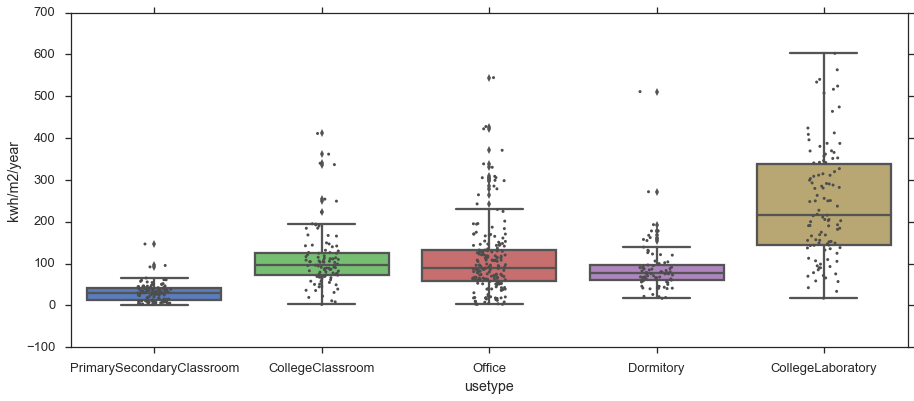

In [61]:
sns.set(style="ticks", palette="muted", color_codes=True)
sns.set_context("talk")
plt.figure(figsize=(15, 6));
ax = sns.boxplot(x="usetype", y="kwh/m2/year", data=annual_sum);
# Add in points to show each observation
sns.stripplot(x="usetype", y="kwh/m2/year", data=annual_sum, jitter=True, size=3, color=".3", linewidth=0);
#ax.set_yscale('log')



In [62]:
annual_sum.usetype.value_counts()

Office                       191
PrimarySecondaryClassroom    114
CollegeLaboratory            106
CollegeClassroom             100
Dormitory                     80
Name: usetype, dtype: int64

Output the 600 buildings as a cleaned temporal dataset for further analysis

In [63]:
temp_cleaned = temp_gaps[temp_norm_daily.columns]

In [64]:
temp_cleaned.count().describe()

count     600.000000
mean     8569.903333
std       304.265075
min      6238.000000
25%      8600.750000
50%      8678.000000
75%      8720.000000
max      8760.000000
dtype: float64

In [65]:
temp_cleaned.to_csv("Temporal_600_Cleaned.csv")

In [66]:
meta = meta.T[temp_cleaned.columns].T#.info()

In [67]:
meta.to_csv("Meta_600_Cleaned.csv")

In [68]:
# def changeto2015(x):
#     try:
#         return x.replace(year=2015)
#     except:
#         return np.nan
    
# def changedfto2015(df, meta):
#     df_trans = pd.DataFrame()
#     for dataset in meta.dataset.unique():
#         print dataset
#         subset = df[df.columns[df.columns.str.contains("_"+dataset+"_")]].dropna(how='all')#.info()
#         subset.index = subset.index.map(lambda t: changeto2015(t))
#         df_trans = pd.merge(df_trans, subset, right_index=True, left_index=True, how='outer')

#     df_trans = df_trans.resample('H').sort_index()#.info()
#     return df_trans

In [69]:
#temp2015_a = changedfto2015(temp_cleaned, meta)

In [70]:
#temp2015_a.info()

# Load Diversity

In [53]:
#electricity = electricity.drop(["Date","Time"], axis=1)
temp_min = temp2015[temp2015>=0].resample('D', how=np.min)
temp_max = temp2015[temp2015>=0].resample('D', how=np.max)
temp_flat = temp_min / temp_max
temp_flat_sorted = temp_flat.T.ix[temp_flat.T.mean(axis=1).sort_values().index].T

In [59]:
plotheatmap_nolabels(temp_flat_sorted.T.reset_index(drop=True).T, 'Picnic')

In [73]:
def boxplot_byusetype(df_agg, ylabel):
    
    s = df_agg['index']
    df_agg = df_agg.join(s.apply(lambda x: pd.Series(x.split('_'))))

    df_agg.columns = ["index",ylabel,"Building Use","dataset","buildingname","col3","col4"]

    sns.set(style="ticks", palette="muted", color_codes=True)
    sns.set_context("talk")
    plt.figure(figsize=(15, 6));
    ax = sns.boxplot(x="Building Use", y=ylabel, data=df_agg);
    # Add in points to show each observation
    sns.stripplot(x="Building Use", y=ylabel, data=df_agg, jitter=True, size=3, color=".3", linewidth=0);
    #ax.set_yscale('log')
    plt.show()
    #sns.swarmplot(x="Building Use", y=ylabel, hue="dataset", data=df_agg)


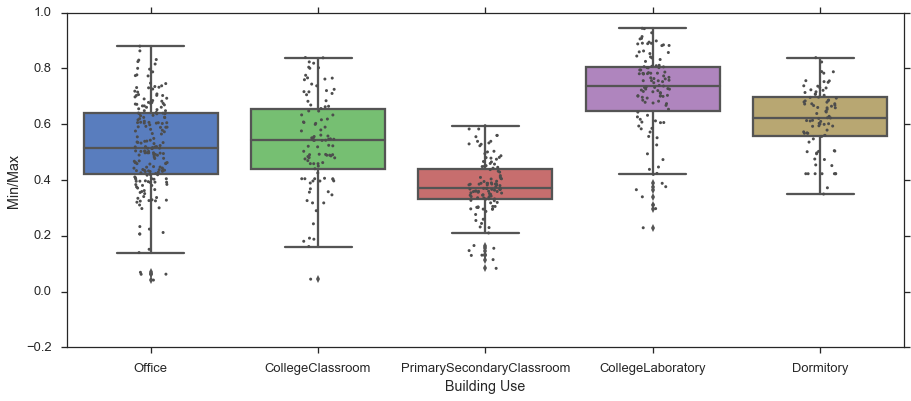

In [74]:
ylabel='Min/Max'
df_agg = pd.DataFrame({ylabel:temp_flat_sorted.fillna(temp_flat_sorted.mean()).mean()}).reset_index()
boxplot_byusetype(df_agg, ylabel)

# Weather Sensitivity

In [75]:
meta

,buildingname,dataend,dataset,datastart,energystarscore,heatingtype,industry,lat,lng,mainheatingtype,...,occupants,primaryspaceusage,rating,siteid,sqft,sqm,subindustry,timezone,yearbuilt,siteid2.1
siteid2,,,,,,,,,,,,,,,,,,,,,
PrimarySecondaryClassroom_enernoc2012_232BurgundyLane,"232, Burgundy Lane,",2012-12-31 23:00:00,enernoc2012,2012-01-01 00:00:00,NaN,NaN,Education,40.2439,-74.9177,NaN,...,NaN,Primary/Secondary Classroom,NaN,92,105530,9804.05,Primary/Secondary School,America/New_York,NaN,PrimarySecondaryClassroom_enernoc2012_232Burgu...
CollegeClassroom_Cornell_SpaceSciencesBuilding,Space Sciences Building,2015-12-31 23:00:00,Cornell,2015-01-01 00:00:00,NaN,NaN,Education,42.5,-76.5,NaN,...,NaN,College Classroom,NaN,SpaceSciencesBuilding.Elec.PowerScout3/kWsystem,56969,5292.59,College/University,America/New_York,1967.0,CollegeClassroom_Cornell_SpaceSciencesBuilding
Office_Cardiff_ElyBreweryWorkshops,Ely Brewery Workshops,2015-11-30 23:00:00,Cardiff,2014-12-01 00:00:00,NaN,Gas,Government,51.4855,-3.23425,Gas,...,NaN,Office,NaN,ely-brewery-workshops,12916.7,1200,"City, County, State",Europe/London,pre 1919,Office_Cardiff_ElyBreweryWorkshops
Office_enernoc2012_857PhillipsStreet,"857, Phillips Street",2012-12-31 23:00:00,enernoc2012,2012-01-01 00:00:00,NaN,NaN,Commercial Property,33.189,-117.237,NaN,...,NaN,Office,NaN,31,294651,27374,Commercial Real Estate,America/Los_Angeles,NaN,Office_enernoc2012_857PhillipsStreet
Office_enernoc2012_SalmonBeachTacoma,"Salmon Beach, Tacoma",2012-12-31 23:00:00,enernoc2012,2012-01-01 00:00:00,NaN,NaN,Commercial Property,47.2979,-122.544,NaN,...,NaN,Office,NaN,30,496517,46127.9,Bank/Financial Services,America/Los_Angeles,NaN,Office_enernoc2012_SalmonBeachTacoma
PrimarySecondaryClassroom_enernoc2012_BuntingRoadPiney,"Bunting Road, Piney",2012-12-31 23:00:00,enernoc2012,2012-01-01 00:00:00,NaN,NaN,Education,38.6347,-75.3582,NaN,...,NaN,Primary/Secondary Classroom,NaN,136,233062,21652.2,Primary/Secondary School,America/New_York,NaN,PrimarySecondaryClassroom_enernoc2012_BuntingR...
Office_Cornell_CentralUtilitiesPlant,Central Utilities Plant,2015-12-31 23:00:00,Cornell,2015-01-01 00:00:00,NaN,NaN,Education,42.4419,-76.4769,NaN,...,NaN,Office,NaN,CentralEnergyPlant.NewOfficeArea.Elec.PowerSco...,92271,8572.25,College/University,America/New_York,2001.0,Office_Cornell_CentralUtilitiesPlant
PrimarySecondaryClassroom_Cardiff_SevernPrimarySchool,Severn Primary School,2015-11-30 23:00:00,Cardiff,2014-12-01 00:00:00,NaN,Gas,Education,51.4829,-3.19971,Gas,...,212,Primary/Secondary Classroom,C,severn-primary-school,31505.9,2927,Primary/Secondary School,Europe/London,pre 1919,PrimarySecondaryClassroom_Cardiff_SevernPrimar...
PrimarySecondaryClassroom_Cardiff_WindsorClivePrimarySchool,Windsor Clive Primary School,2015-11-30 23:00:00,Cardiff,2014-12-01 00:00:00,NaN,Gas,Education,51.4786,-3.25206,Gas,...,219,Primary/Secondary Classroom,C,windsor-clive-primary-school,47070.5,4373,Primary/Secondary School,Europe/London,1919-1945,PrimarySecondaryClassroom_Cardiff_WindsorClive...


# Daily Pattern Consistency

In [149]:
def discretizer(row, breakpoints):
    return np.where(breakpoints > float(row))[0][0]
def stringizer(row):
    return ''.join(string.ascii_letters[int(row['step'])])
def adddate(df):
    df['Date'] = df.index.map(lambda t: t.date())
    df['Time'] = df.index.map(lambda t: t.time())
    return df
def SAXizer(df, symbol_count, breakfreq):
    #x = df.fillna(method='ffill')
    x = df.dropna()
    y = (x - x.mean()) / x.std()
    z = pd.DataFrame(y.resample(breakfreq).dropna())
    z.columns = ["numbers"]   
    breakpoints = norm.ppf(np.linspace(1./symbol_count, 1-1./symbol_count, symbol_count-1))
    breakpoints = np.concatenate((breakpoints, np.array([np.Inf])))  
    z['step'] = z.apply(discretizer, axis=1, args=[breakpoints])
    z['letter'] = z.apply(stringizer, axis=1)
    z = adddate(z)
    zpivot = z.pivot(index='Date', columns='Time', values='letter')   
    SAXstrings = zpivot.dropna().sum(axis=1) 
    return SAXstrings

In [150]:
a = 3
w = '6h'
meternames = temp2015.columns

SAXwords = pd.DataFrame(index=pd.date_range("2015-01-01", "2015-12-31", freq='D'))
SAXfreq = pd.DataFrame(index=pd.date_range("2015-01-01", "2015-12-31", freq='D'))
counter = 0
for datapoint in meternames:
    SAXstrings = SAXizer(temp2015[datapoint].dropna(), a, w)
    SAXwords[datapoint] = SAXstrings
    counts = SAXstrings.value_counts()
    stringfreq =  counts[SAXstrings]/SAXstrings.count()
    SAXstrings = pd.DataFrame(SAXstrings, columns=['string'])
    SAXstrings['freq'] = stringfreq.values
    SAXfreq[datapoint] = SAXstrings['freq']

In [151]:
SAXwords.iloc[:,5:10].head()

,CollegeClassroom_ASU_CODNorth,CollegeClassroom_ASU_CODSouth,CollegeClassroom_ASU_ClassroomBuilding,CollegeClassroom_ASU_CowdenFamilyResources,CollegeClassroom_ASU_CreativityHall
2015-01-01,aaaa,aaaa,bccb,aaaa,acbb
2015-01-02,aaaa,aaba,abbc,abca,acbb
2015-01-03,aaaa,aaaa,baaa,abba,acaa
2015-01-04,aaaa,aaaa,aaaa,abba,acaa
2015-01-05,aaba,abba,abcb,abca,acaa


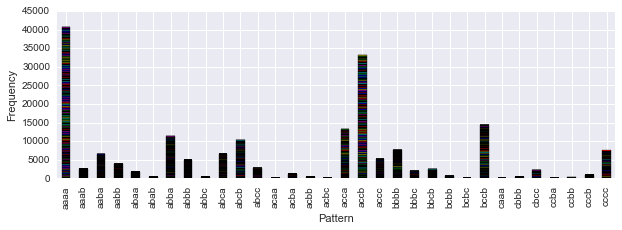

In [152]:
patternfreqcount = pd.DataFrame()
for meter in meternames:
    patternfreqcount[meter] = SAXwords[meter].value_counts()
ax = patternfreqcount.sort_index().plot(kind='bar', figsize=(10,3), legend=False, stacked=True);
ax.set_xlabel("Pattern")
ax.set_ylabel("Frequency");

In [153]:
SAXfreq_sorted = SAXfreq.T.ix[SAXfreq.T.sum(axis=1).sort_values().index].T

In [154]:
#SAXfreq_sorted

In [155]:
plotheatmap(SAXfreq_sorted, 'Portland')

In [156]:
boxplot_byusetype(SAXfreq_sorted, "Pattern Freq")

NameError: name 'boxplot_byusetype' is not defined

# Long term consistency

In [18]:
Minimum = 30
Beta = 0.005
Degrees = 3

In [ ]:
%%R 
library(BreakoutDetection)